In [7]:
!pip install ultralytics
!pip install git+https://github.com/facebookresearch/detectron2.git

### 📚 Краткое описание представленных методов Object Detection

---

#### 🔹 **HOG + SVM**
- **Тип**: Классический алгоритм
- **Принцип**: Выделяются градиенты (HOG-фичи), затем классифицируются при помощи SVM.
- **Особенности**: Быстрый, работает без нейросетей, применим к задачам типа pedestrian detection.

---

#### 🔹 **Fast R-CNN**
- **Тип**: Two-stage
- **Принцип**: Один раз прогоняет всё изображение через сверточную сеть. Далее используется **RoI Pooling** для регионов, предложенных Selective Search. На выходе — классификация и регрессия бокса.
- **Особенности**: Быстрее R-CNN, но всё ещё использует внешний генератор регионов.

---

#### 🔹 **Faster R-CNN**
- **Тип**: Two-stage
- **Принцип**: Вводит **Region Proposal Network (RPN)**, которая генерирует области интереса прямо на feature map. Эти регионы передаются на классификацию и регрессию.
- **Особенности**: Более быстрая и точная альтернатива Fast R-CNN.

---

#### 🔹 **YOLO (v5/v8/v11 и др.)**
- **Тип**: One-stage
- **Принцип**: Делит изображение на сетку и предсказывает боксы и классы прямо с выхода нейросети. Нет отдельного этапа предложений.
- **Особенности**: Очень высокая скорость, используется в реальном времени.

---

#### 🔹 **SSD (Single Shot Detector)**
- **Тип**: One-stage
- **Принцип**: Делает предсказания на нескольких уровнях feature map. Использует anchor boxes разных размеров и соотношений.
- **Особенности**: Быстрый и компактный, подходит для мобильных устройств.

---

#### 🔹 **RetinaNet**
- **Тип**: One-stage
- **Принцип**: Добавляет **Focal Loss** для борьбы с дисбалансом между фоном и объектами. Использует Feature Pyramid Network (FPN).
- **Особенности**: Баланс между скоростью и точностью. Хорошо работает с несбалансированными данными.

---

#### 🔹 **FCOS (Fully Convolutional One-Stage)**
- **Тип**: One-stage, Anchor-Free
- **Принцип**: Не использует anchor boxes. Каждый пиксель предсказывает, есть ли объект, его координаты и класс.
- **Особенности**: Простота архитектуры, высокая универсальность, хорошо работает с плотными и мелкими объектами.

---

#### 🔹 **DETR (DEtection TRansformer)**
- **Тип**: One-stage, основан на Transformer
- **Принцип**: Использует encoder-decoder архитектуру трансформера для глобального внимания по изображению. Объекты предсказываются как "object queries".
- **Особенности**: Нет NMS, нет якорей, требует большой объём данных и ресурсов.

## HOG + SVM

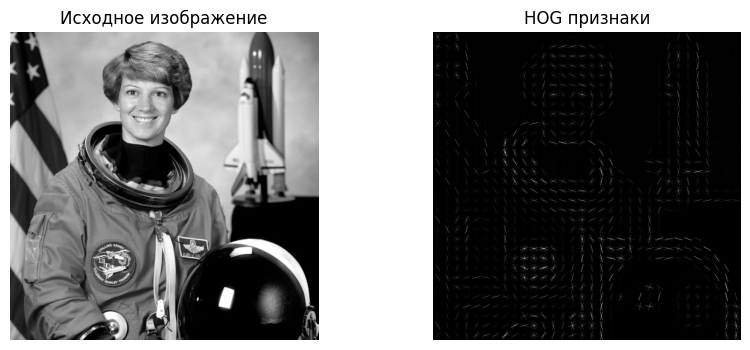

In [8]:
# @title HOG + SVM

from skimage.feature import hog
from skimage import data
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
import numpy as np

image = data.astronaut()
gray = rgb2gray(image)

fd, hog_image = hog(
    gray,
    orientations=8,
    pixels_per_cell=(16, 16),
    cells_per_block=(1, 1),
    visualize=True,
    feature_vector=True
)

plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(gray, cmap="gray")
plt.title("Исходное изображение")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(hog_image, cmap="gray")
plt.title("HOG признаки")
plt.axis('off')

plt.show()

## Faster R-CNN

/usr/local/lib/python3.11/dist-packages/torchvision/utils.py:233: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


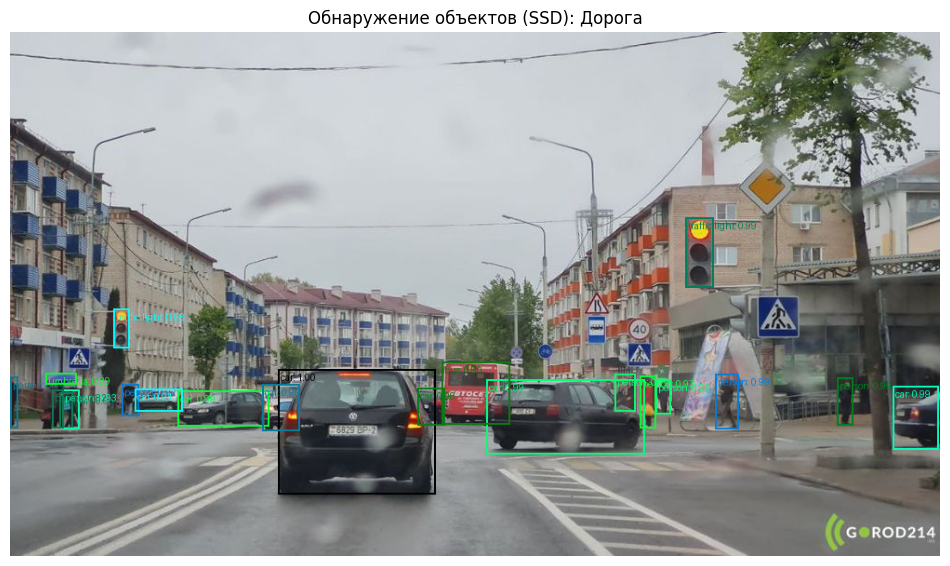

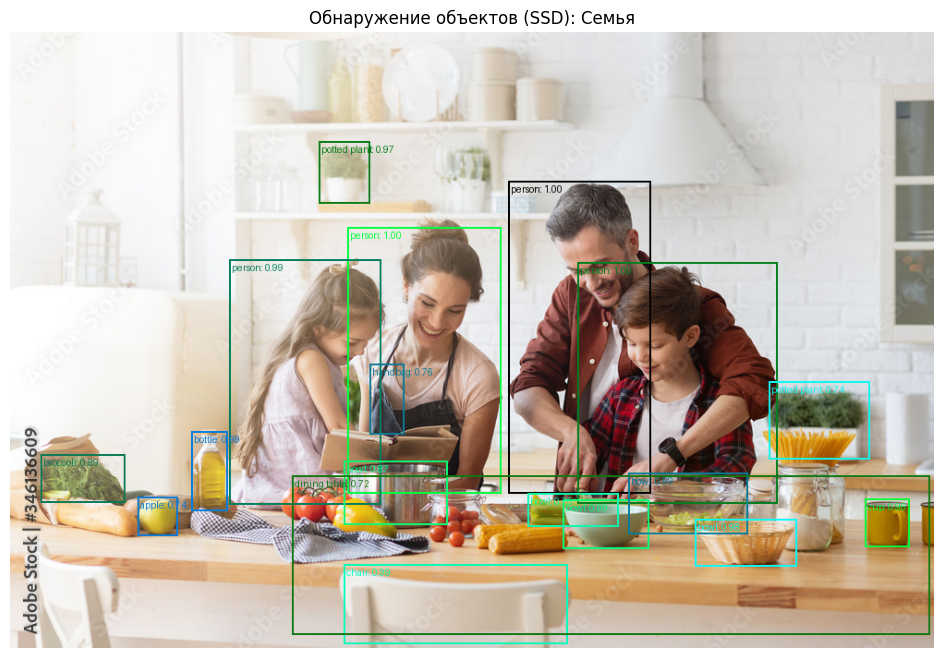

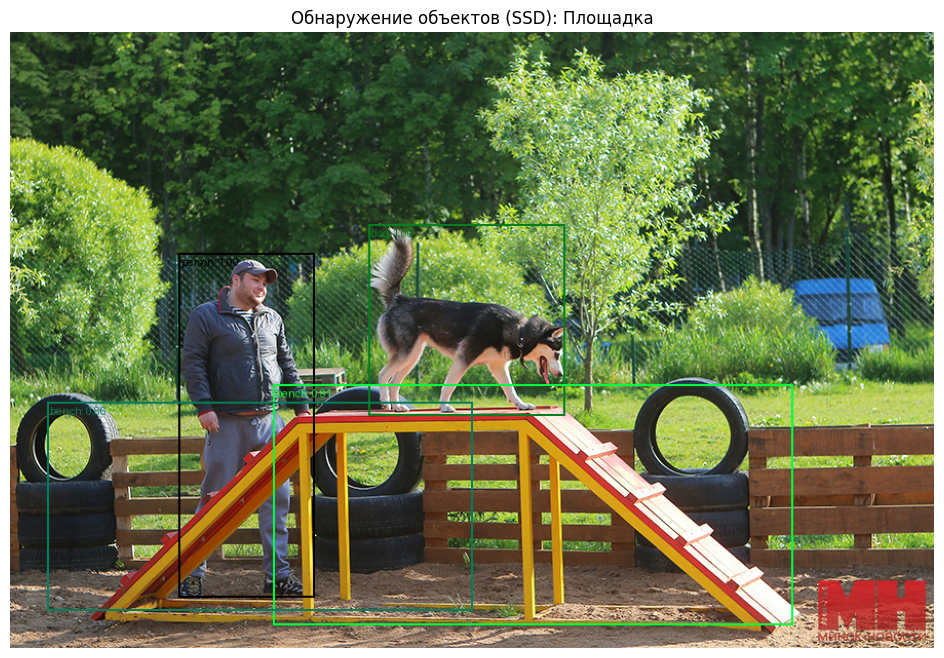

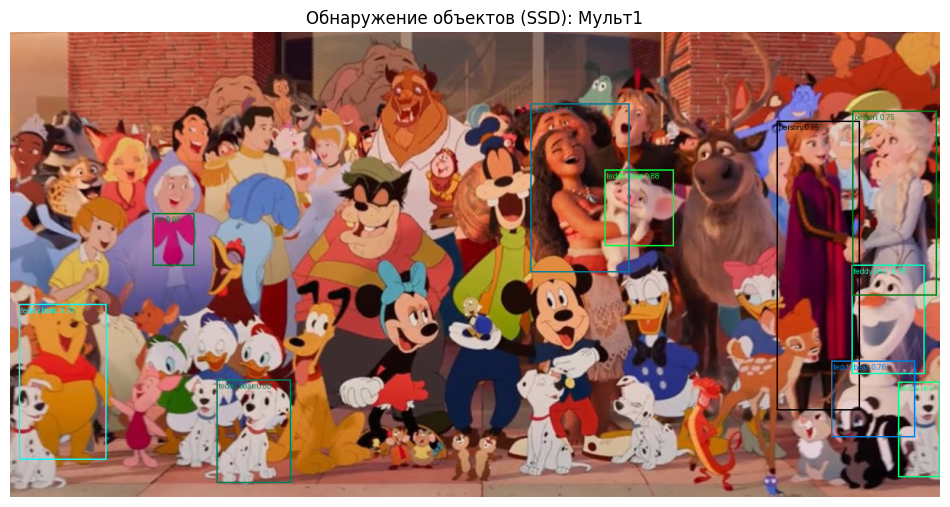

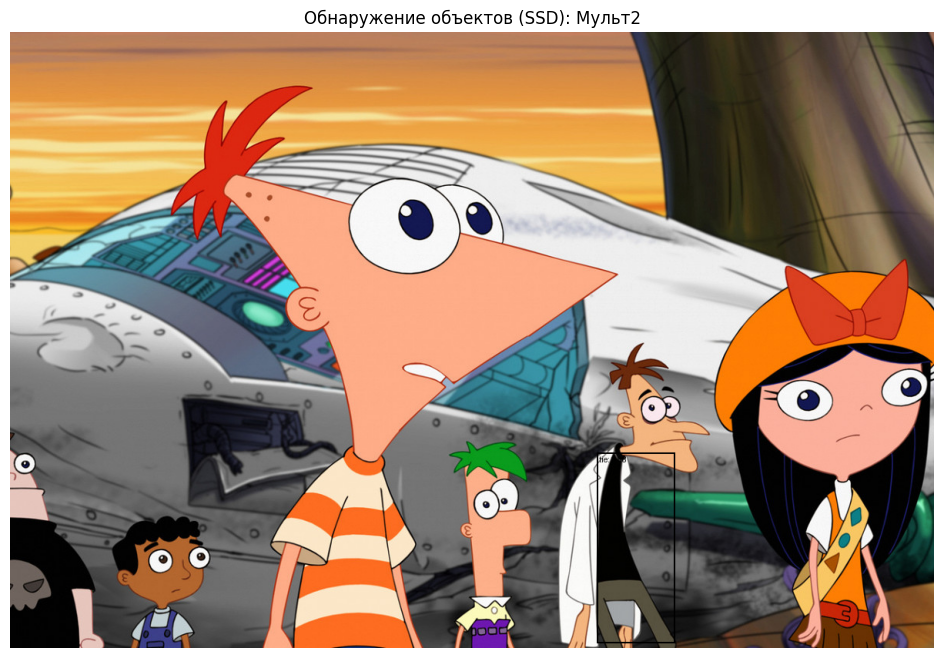

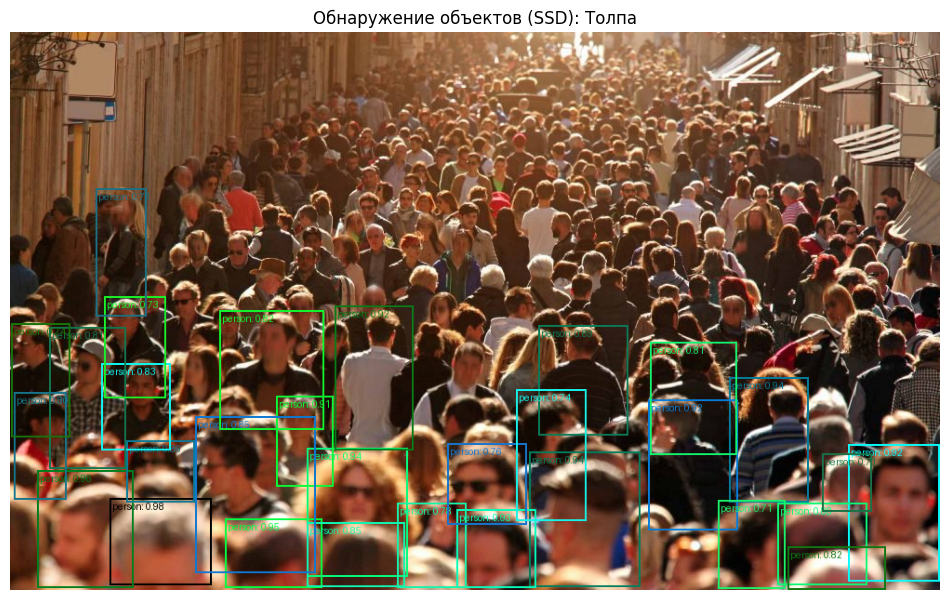

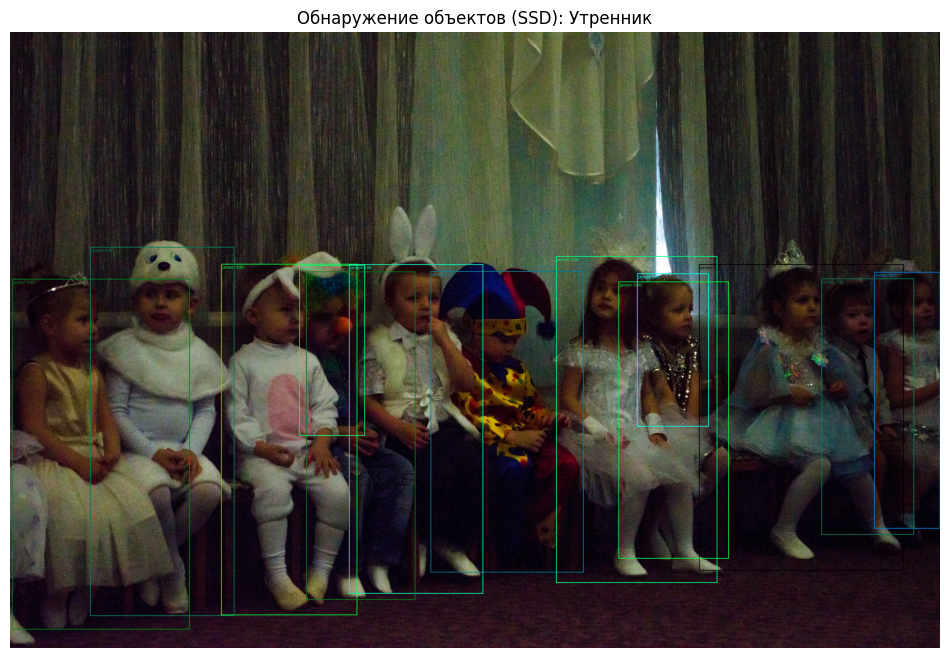

Время выполнения: 50.44 секунд


In [9]:
# @title Faster R-CNN фото

import time
import torch
import torchvision.transforms as T
import matplotlib.pyplot as plt
from torchvision.io import read_image
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.utils import draw_bounding_boxes
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights
from PIL import Image, ImageDraw, ImageFont
from torchvision.transforms.functional import to_tensor

start_time = time.time()

# Загружаем модель и веса с метками
weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn(weights=weights).eval()
transform = weights.transforms()

# Классы COCO
categories = weights.meta["categories"]

image_paths = [
    '/content/drive/MyDrive/pictures_for_detection/Дорога.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Семья.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Площадка.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon2.jpg',
    '/content/drive/MyDrive/pictures_for_detection/crowd.jpg',
    '/content/drive/MyDrive/pictures_for_detection/sun.jpg',
]
titles = ["Дорога", "Семья", "Площадка", "Мульт1", "Мульт2", "Толпа", "Утренник"]

threshold = 0.7

for path, title in zip(image_paths, titles):

    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (SSD): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

In [10]:
# @title Faster R-CNN видео

import cv2
from torchvision.transforms.functional import to_pil_image
from IPython.display import Video, display
import torchvision.transforms.functional as F


# Таймер
start_time = time.time()

# Загружаем модель с предобученными весами COCO
weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn(weights=weights).eval()
categories = weights.meta["categories"]
transform = weights.transforms()

# Путь к видео
video_path = "/content/drive/MyDrive/pictures_for_detection/1.mp4"
cap = cv2.VideoCapture(video_path)

# Проверка открытия файла
if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

# Видео параметры
fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Выходной файл
output_path = "output_FasterRCNN_people.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.5  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    # Фильтрация по порогу
    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    # Отрисовка
    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

# Время выполнения
end_time = time.time()
print(f"\nPeople Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")


start_time = time.time()

video_path = "/content/drive/MyDrive/pictures_for_detection/city.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_FasterRCNN_city.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.5  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    from PIL import Image

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    # Фильтрация по порогу
    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    # Отрисовка
    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

# Время выполнения
end_time = time.time()
print(f"\nCity Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"City Время выполнения: {end_time - start_time:.2f} секунд")


People Итог: обработано 100 кадров из 100
People Время выполнения: 702.43 секунд

City Итог: обработано 100 кадров из 100
City Время выполнения: 705.15 секунд


## YOLOv11

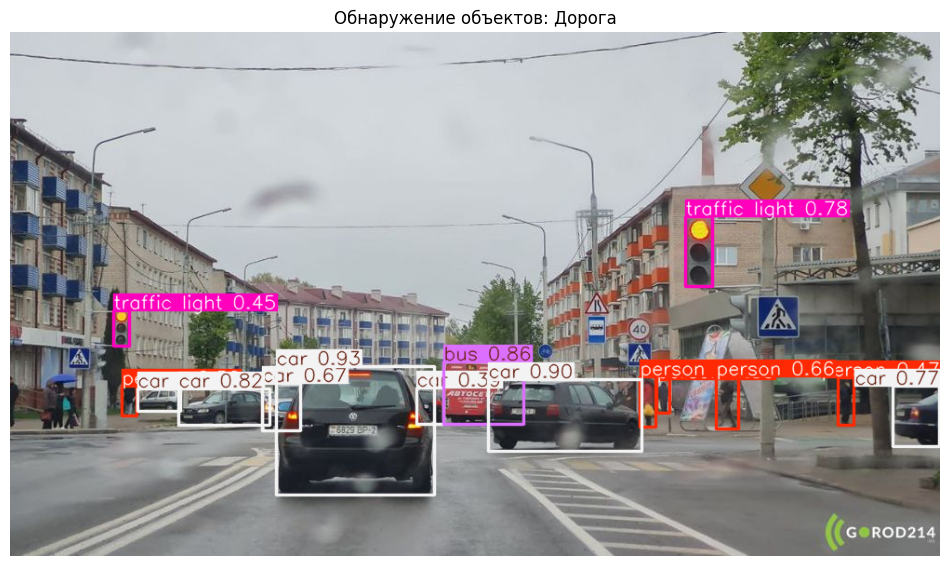

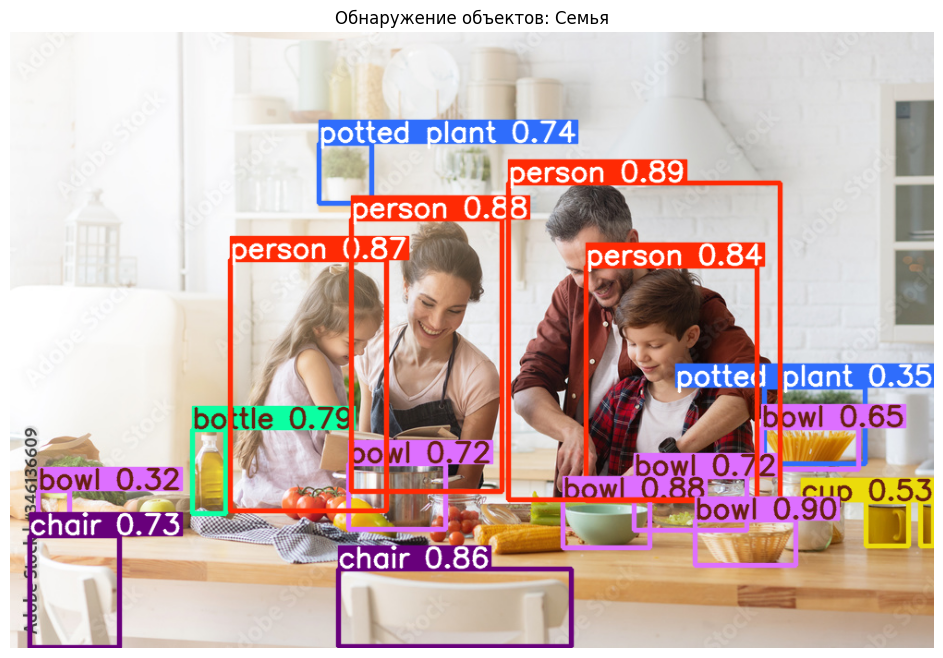

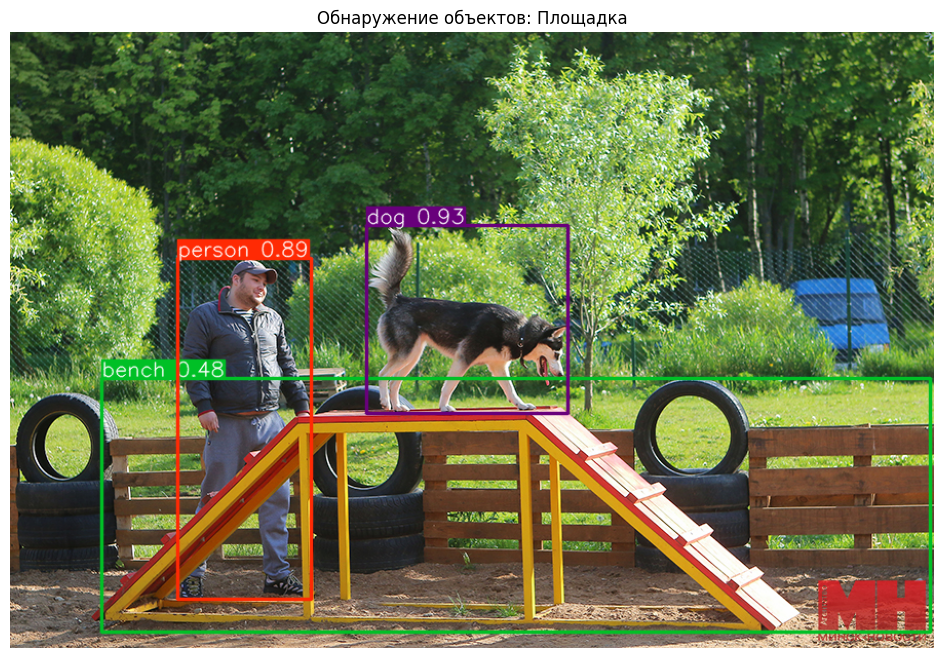

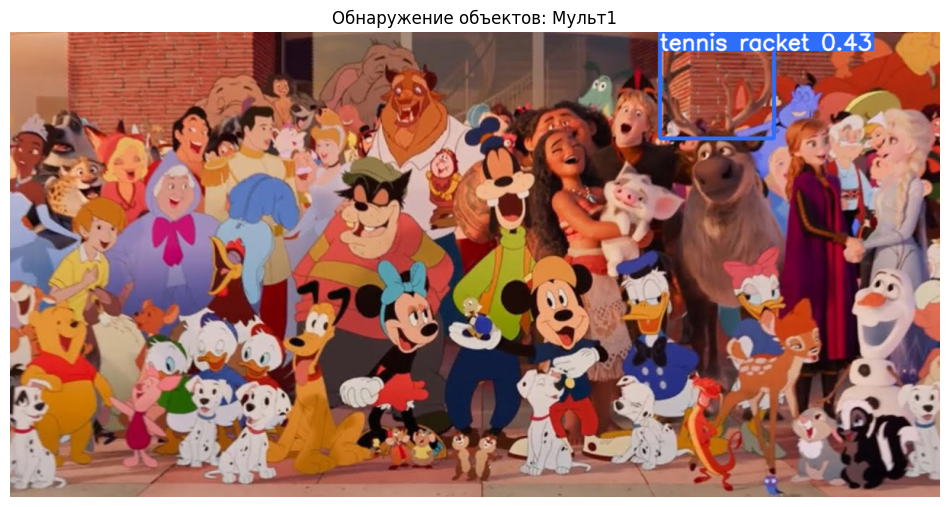

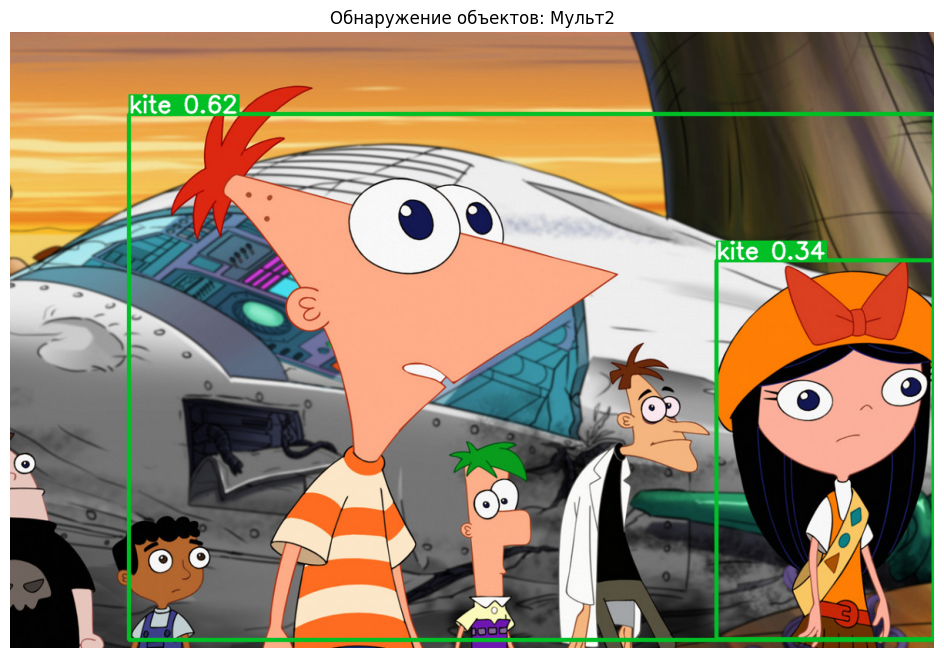

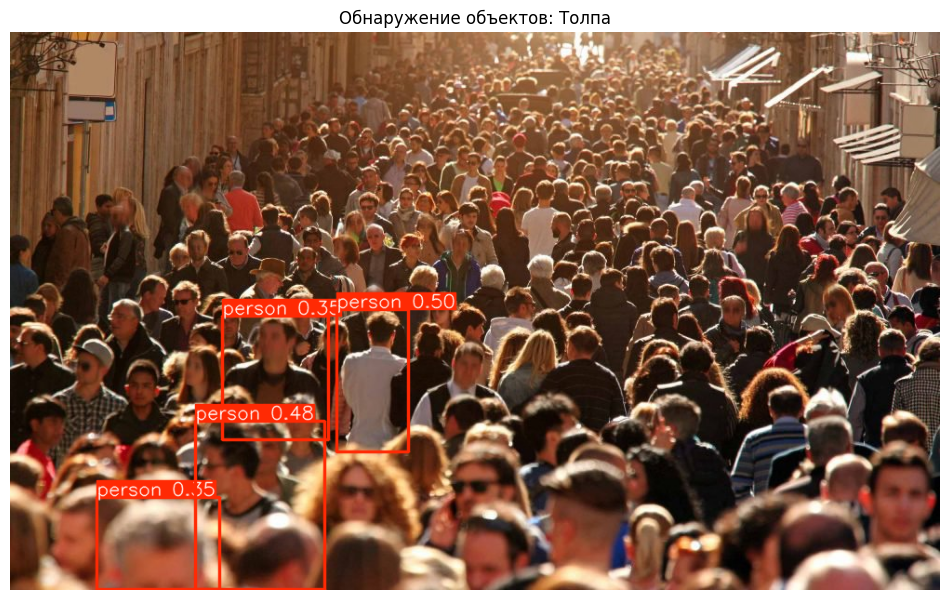

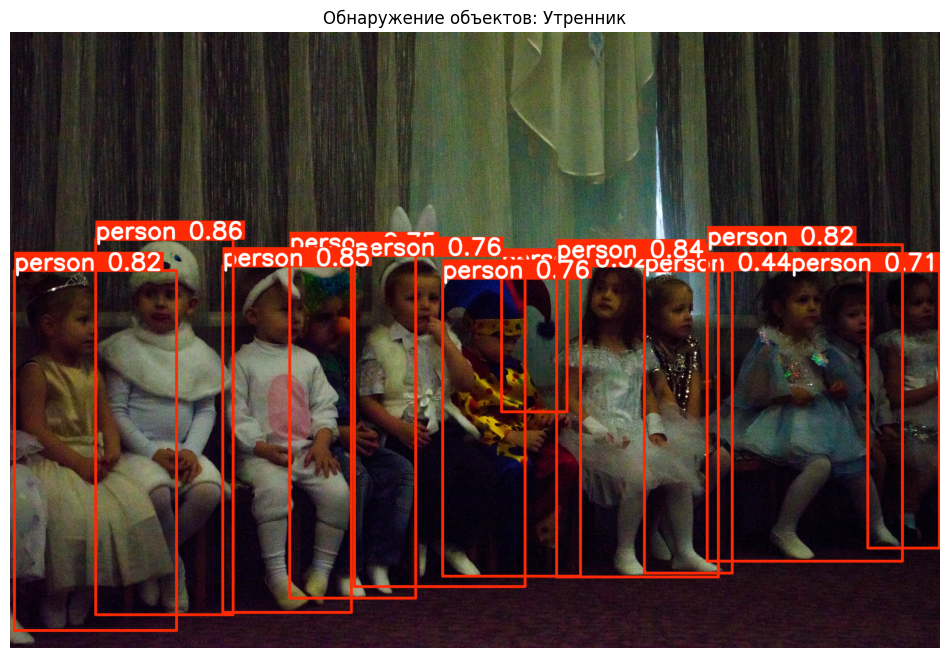

Время выполнения: 9.50 секунд


In [24]:
# @title YOLOv11 фото

from ultralytics import YOLO


start_time = time.time()

model = YOLO('yolo11l.pt')  # Можно заменить на 'yolo11n.pt', 'yolo11m.pt', 'yolo11l.pt' или 'yolo11x.pt'. Каждая последующая более тяжёлая

image_paths = [
    '/content/drive/MyDrive/pictures_for_detection/Дорога.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Семья.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Площадка.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon2.jpg',
    '/content/drive/MyDrive/pictures_for_detection/crowd.jpg',
    '/content/drive/MyDrive/pictures_for_detection/sun.jpg',
]
titles = ["Дорога", "Семья", "Площадка", "Мульт1", "Мульт2", "Толпа", "Утренник"]

conf_threshold = 0.3

for img_path, title in zip(image_paths, titles):

    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    results = model.predict(source=img_rgb, conf=conf_threshold, verbose=False)

    result = results[0]
    boxes = result.boxes
    names = model.names

    annotated_img = result.plot()

    plt.figure(figsize=(12, 8))
    plt.imshow(annotated_img)
    plt.axis("off")
    plt.title(f"Обнаружение объектов: {title}")
    plt.show()

end_time = time.time()
execution_time = end_time - start_time
print(f"Время выполнения: {execution_time:.2f} секунд")

In [23]:
# @title YOLOv11 видео


start_time = time.time()

model = YOLO('yolo11l.pt')  # можно заменить на другую версию

video_path = "/content/drive/MyDrive/pictures_for_detection/1.mp4"

cap = cv2.VideoCapture(video_path)

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter("output_yolo_people.avi", cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    results = model.predict(source=frame, conf=0.5, verbose=False)
    result = results[0]

    annotated_frame = result.plot()

    out.write(annotated_frame)

    if frame_count >= 100:  # Например, показываем только первые 50 кадров
        break

cap.release()
out.release()

end_time = time.time()
print(f"People Обработано кадров: {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")


start_time = time.time()

model = YOLO('yolo11l.pt')  # можно заменить на другую версию

video_path = "/content/drive/MyDrive/pictures_for_detection/city.mp4"

cap = cv2.VideoCapture(video_path)

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter("output_yolo_city.avi", cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    results = model.predict(source=frame, conf=0.5, verbose=False)
    result = results[0]

    annotated_frame = result.plot()

    out.write(annotated_frame)

    if frame_count >= 100:  # Например, показываем только первые 50 кадров
        break

cap.release()
out.release()

end_time = time.time()
print(f"City Обработано кадров: {frame_count}")
print(f"City Время выполнения: {end_time - start_time:.2f} секунд")

People Обработано кадров: 100
People Время выполнения: 84.37 секунд
City Обработано кадров: 100
City Время выполнения: 83.02 секунд


## SSD (Single-Shot Detector)

/usr/local/lib/python3.11/dist-packages/torchvision/utils.py:233: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


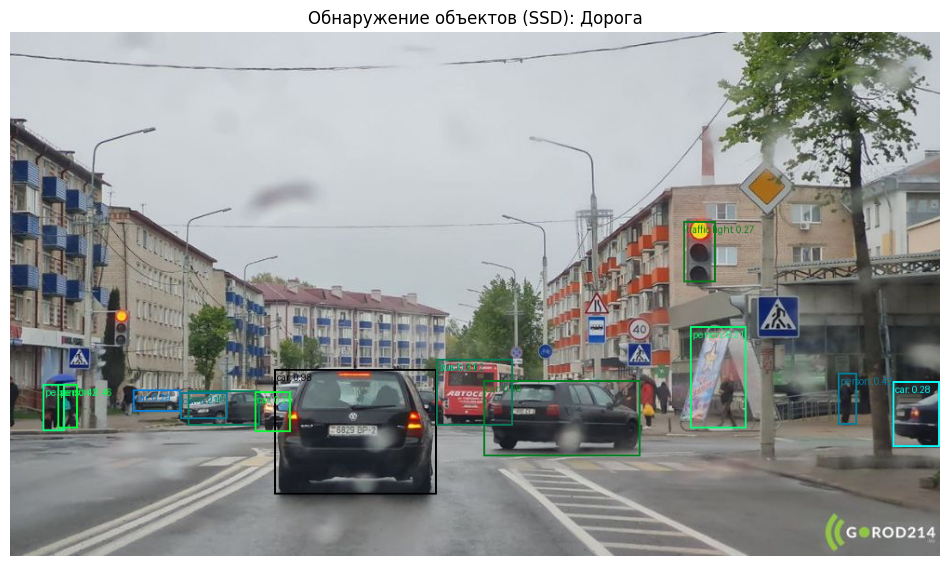

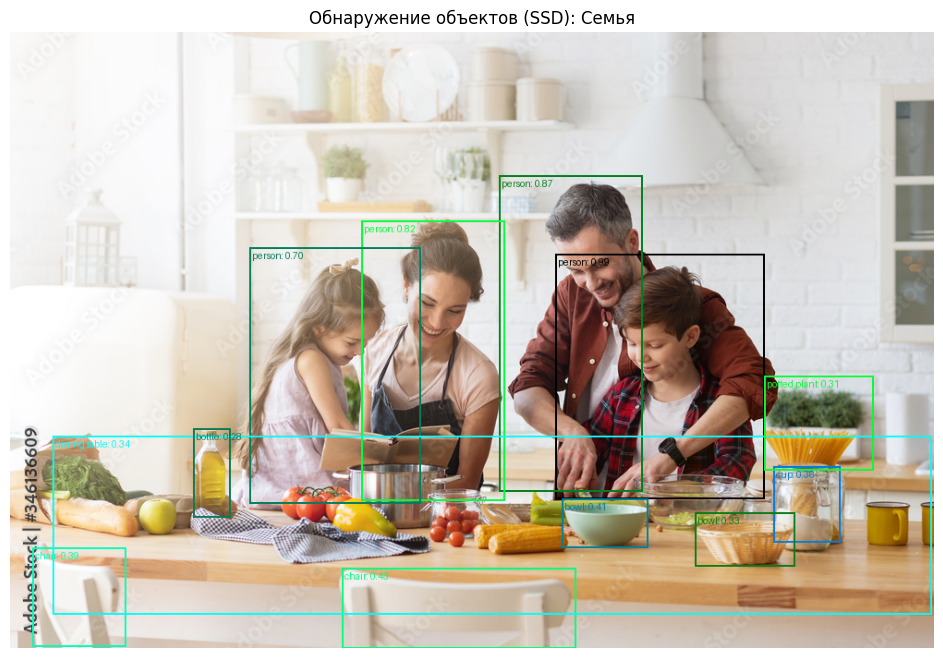

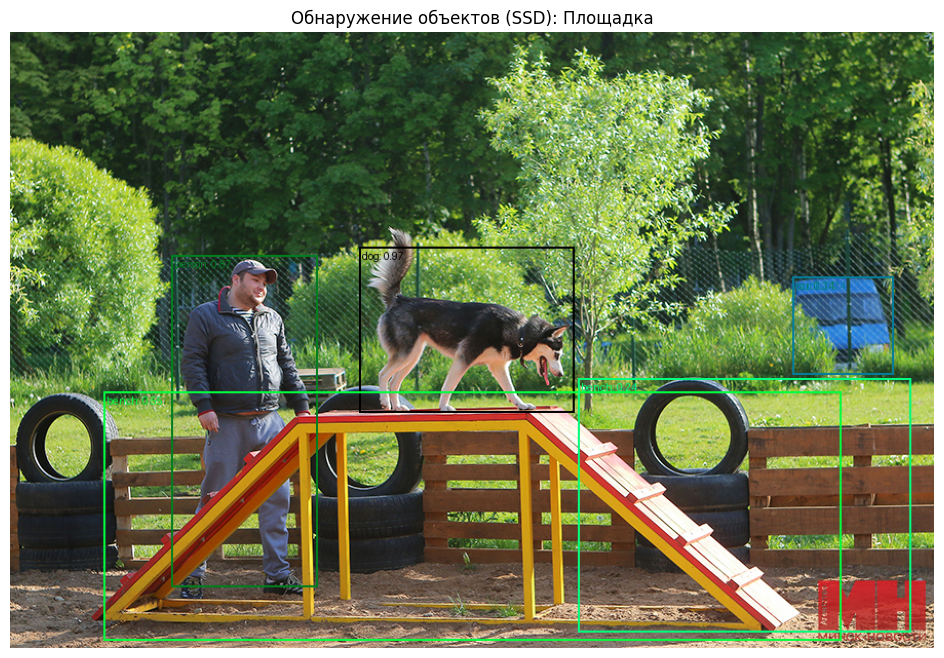

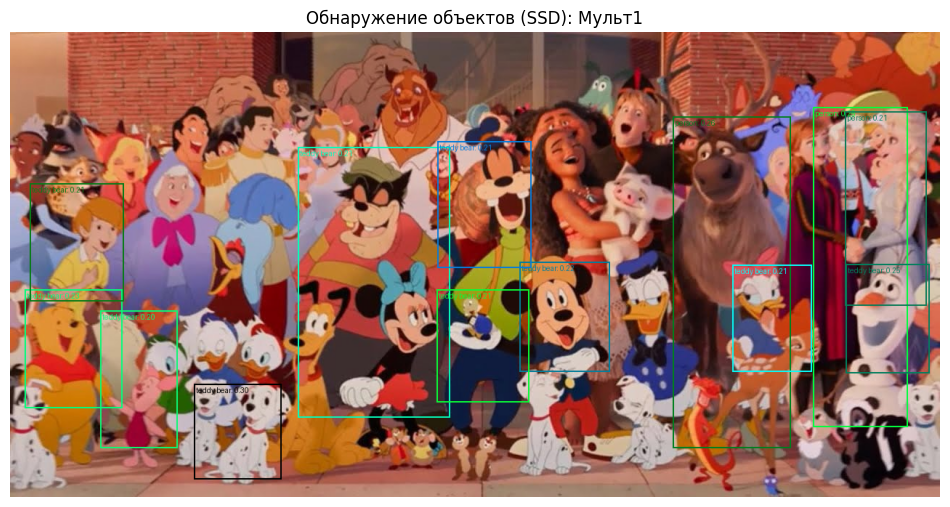

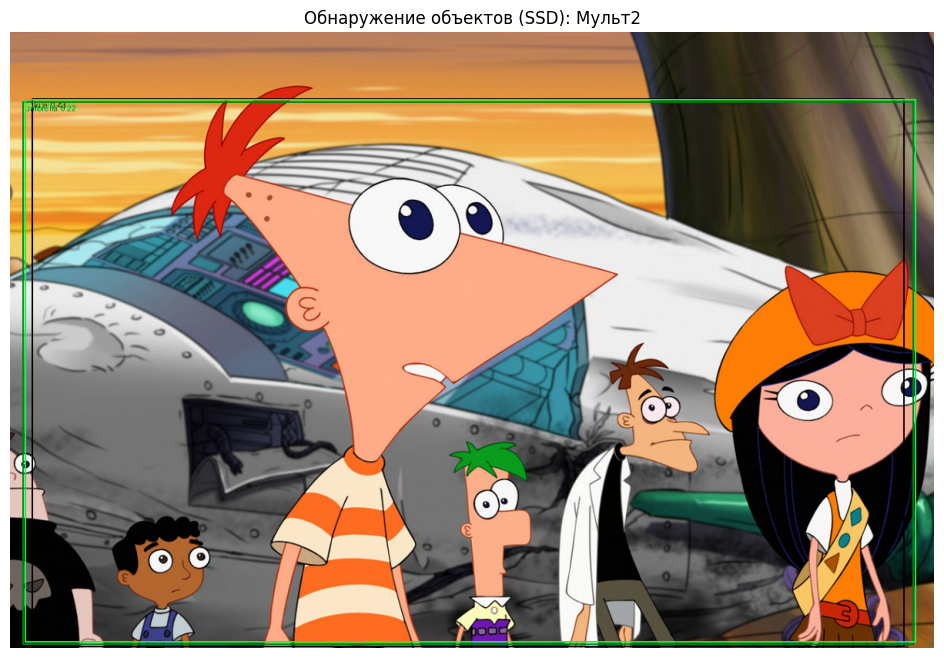

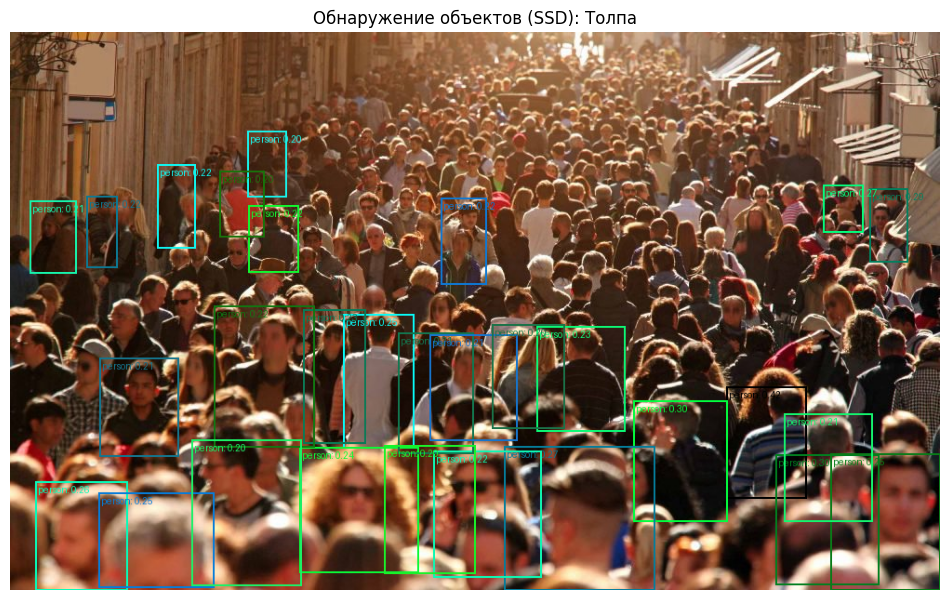

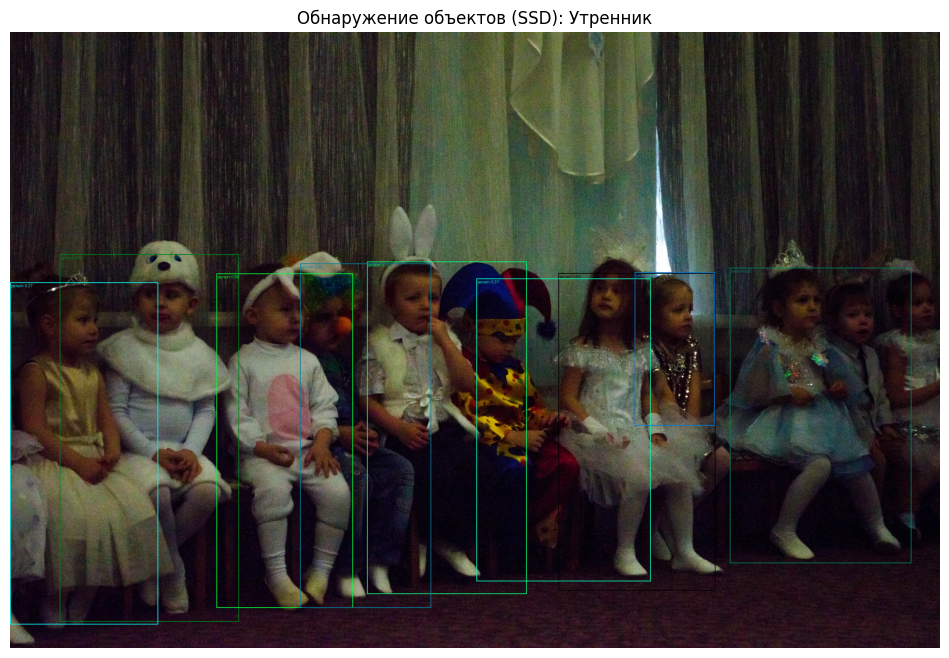

Время выполнения: 14.67 секунд


In [13]:
# @title SSD (Single-Shot Detector) фото

from torchvision.models.detection import ssd300_vgg16, SSD300_VGG16_Weights


start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights).eval()

categories = weights.meta["categories"]

transform = weights.transforms()

image_paths = [
    '/content/drive/MyDrive/pictures_for_detection/Дорога.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Семья.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Площадка.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon2.jpg',
    '/content/drive/MyDrive/pictures_for_detection/crowd.jpg',
    '/content/drive/MyDrive/pictures_for_detection/sun.jpg',
]
titles = ["Дорога", "Семья", "Площадка", "Мульт1", "Мульт2", "Толпа", "Утренник"]

threshold = 0.2

for path, title in zip(image_paths, titles):

    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (SSD): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

In [20]:
# @title SSD (Single-Shot Detector) видео

start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights).eval()
categories = weights.meta["categories"]
transform = weights.transforms()

video_path = "/content/drive/MyDrive/pictures_for_detection/1.mp4"  # Заменить на свой путь
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_ssd_people.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.2  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    from PIL import Image

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nPeople Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")


start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights).eval()
categories = weights.meta["categories"]
transform = weights.transforms()

video_path = "/content/drive/MyDrive/pictures_for_detection/city.mp4"  # Заменить на свой путь
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_ssd_city.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.2  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    from PIL import Image

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nCity Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"City Время выполнения: {end_time - start_time:.2f} секунд")


People Итог: обработано 100 кадров из 100
People Время выполнения: 107.28 секунд

City Итог: обработано 100 кадров из 100
City Время выполнения: 102.19 секунд


## FCOS

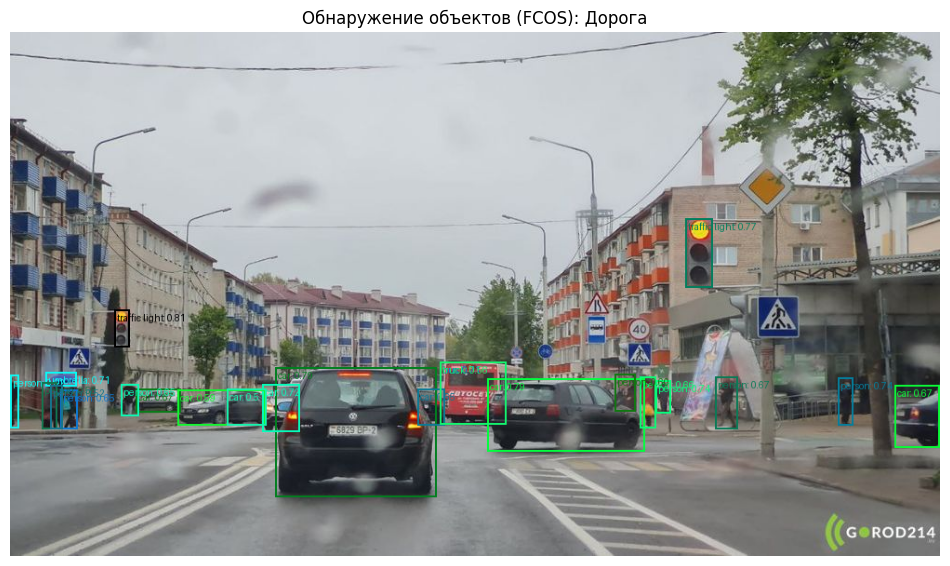

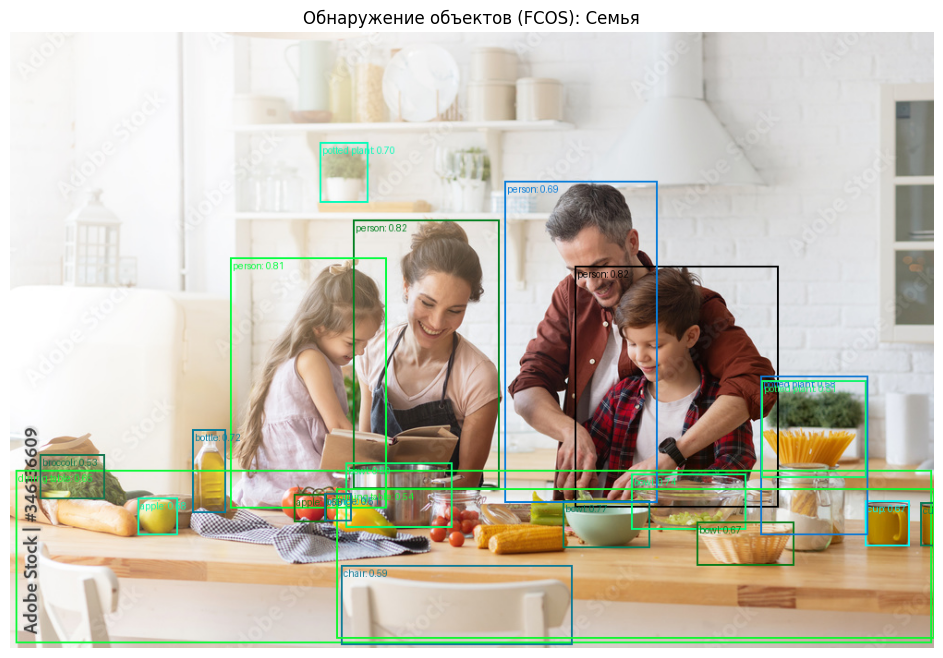

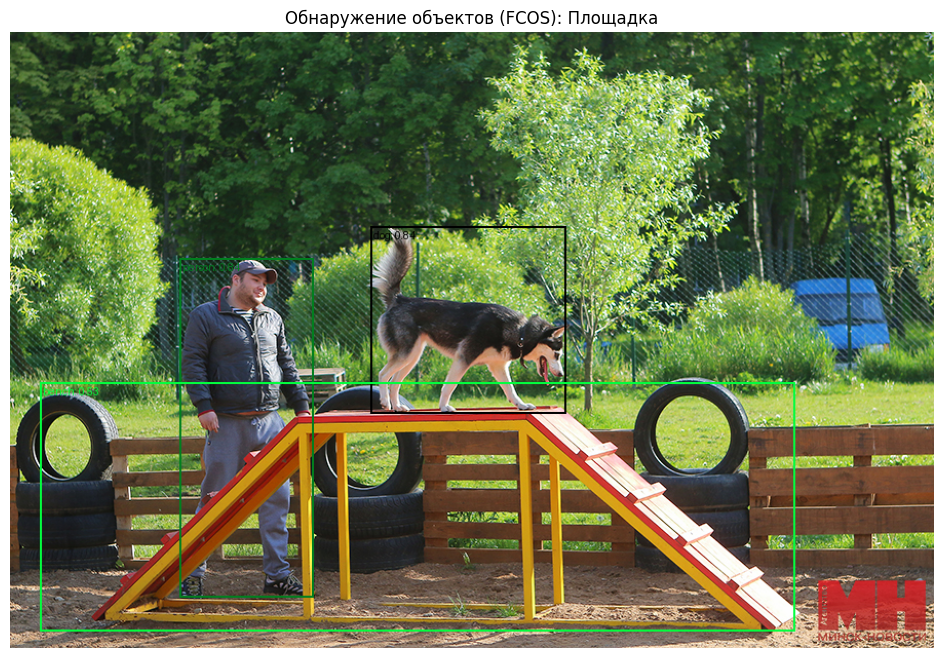

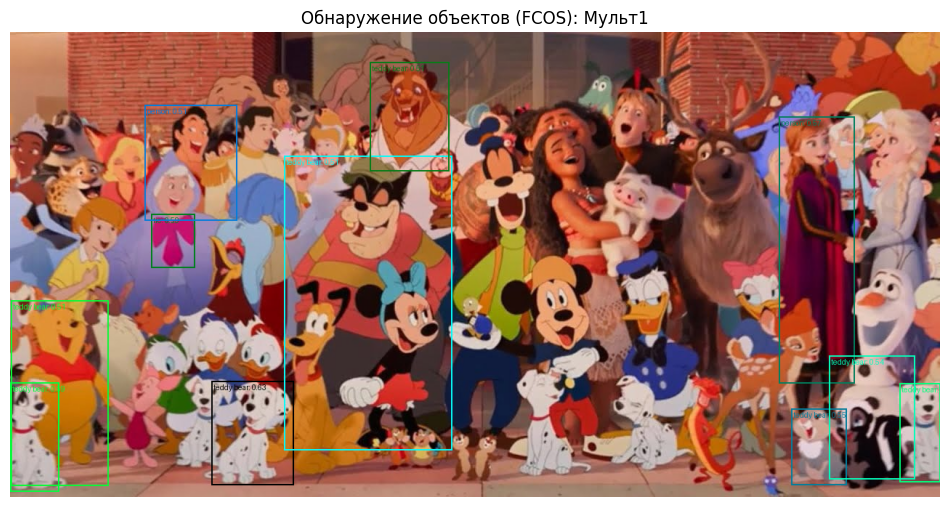

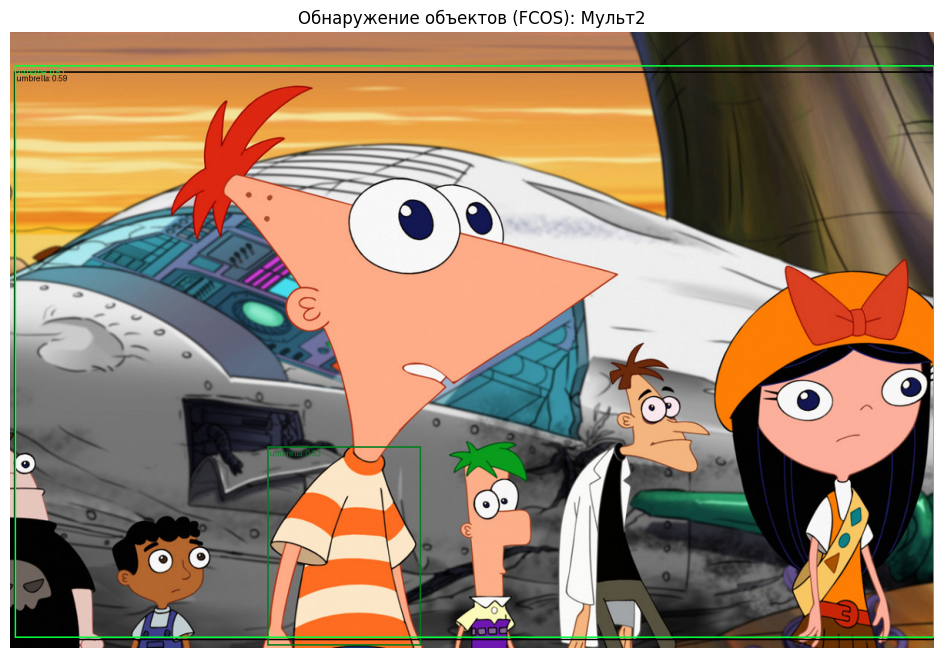

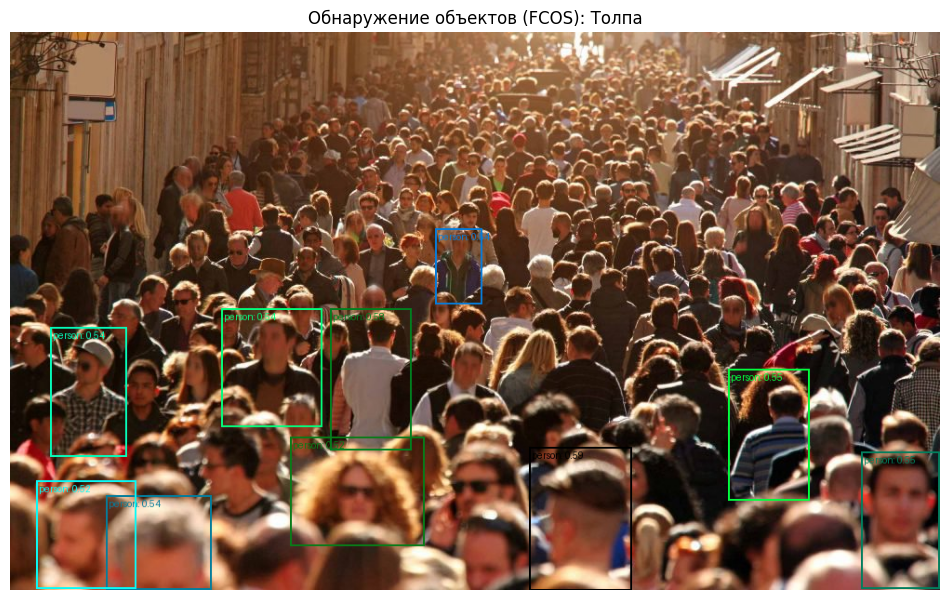

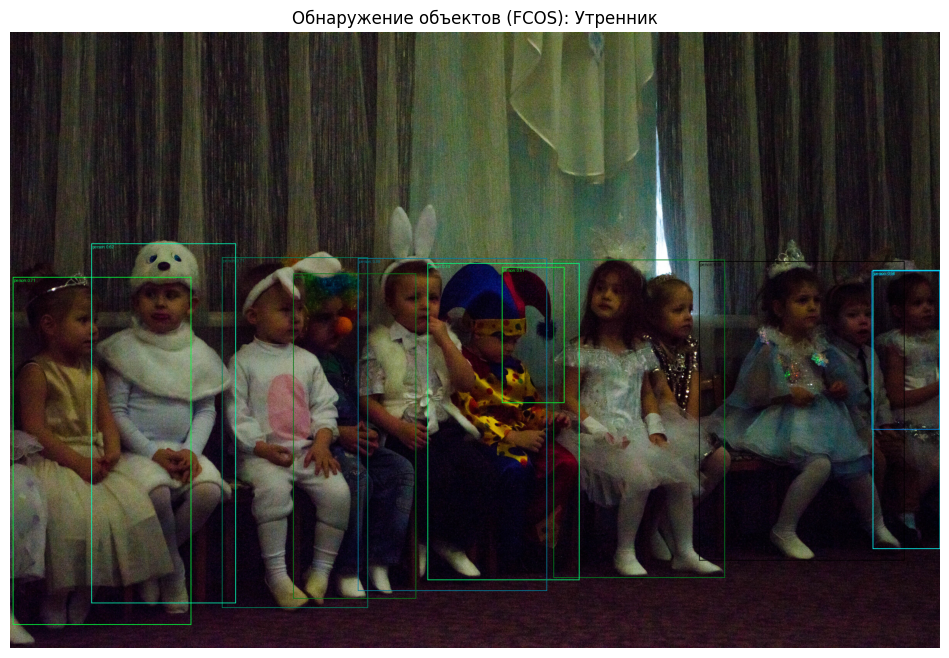

Время выполнения: 46.32 секунд


In [15]:
# @title FCOS фото

from torchvision.models.detection import fcos_resnet50_fpn, FCOS_ResNet50_FPN_Weights


start_time = time.time()

weights = FCOS_ResNet50_FPN_Weights.DEFAULT
model = fcos_resnet50_fpn(weights=weights)
model.eval()

categories = weights.meta["categories"]
transform = weights.transforms()

image_paths = [
    '/content/drive/MyDrive/pictures_for_detection/Дорога.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Семья.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Площадка.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon2.jpg',
    '/content/drive/MyDrive/pictures_for_detection/crowd.jpg',
    '/content/drive/MyDrive/pictures_for_detection/sun.jpg',
]
titles = ["Дорога", "Семья", "Площадка", "Мульт1", "Мульт2", "Толпа", "Утренник"]

threshold = 0.5

for path, title in zip(image_paths, titles):
    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (FCOS): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

In [16]:
# @title FCOS видео

start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights).eval()
categories = weights.meta["categories"]
transform = weights.transforms()

video_path = "/content/drive/MyDrive/pictures_for_detection/1.mp4"  # Заменить на свой путь
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_ssd_people.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.4  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    from PIL import Image

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nPeople Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")


start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights).eval()
categories = weights.meta["categories"]
transform = weights.transforms()

video_path = "/content/drive/MyDrive/pictures_for_detection/city.mp4"  # Заменить на свой путь
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_ssd_people.avi"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

threshold = 0.4  # Порог уверенности
frame_count = 0
processed_frames = 0
max_processed = 100  # Максимум обработанных кадров

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # Обрабатываем каждый n-кадр кадр
    n = 1
    if frame_count % n != 0:
        out.write(frame)
        continue

    from PIL import Image

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame_pil = Image.fromarray(frame_rgb)
    img_input = transform(frame_pil).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    keep = output["scores"] > threshold
    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]

    label_names = [f"{categories[int(label)]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_tensor = torch.tensor(frame_rgb).permute(2, 0, 1).contiguous()
    img_tensor = img_tensor.to(dtype=torch.uint8)

    img_with_boxes = draw_bounding_boxes(
        img_tensor, boxes, labels=label_names, colors="red", width=2, font_size=18
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    out.write(img_bgr)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nCity Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"City Время выполнения: {end_time - start_time:.2f} секунд")


People Итог: обработано 100 кадров из 100
People Время выполнения: 111.59 секунд

City Итог: обработано 100 кадров из 100
City Время выполнения: 102.52 секунд


## DETR (DEtection TRansformer)

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


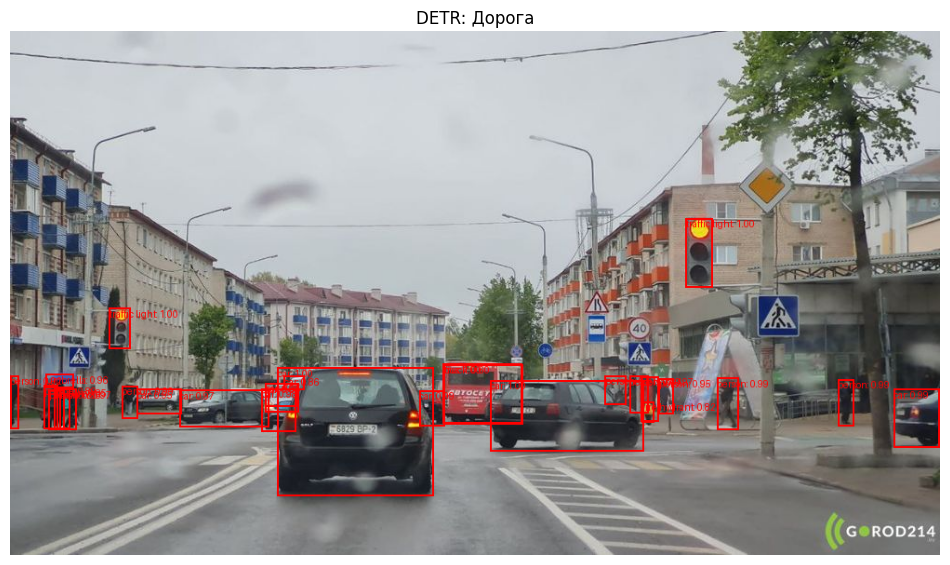

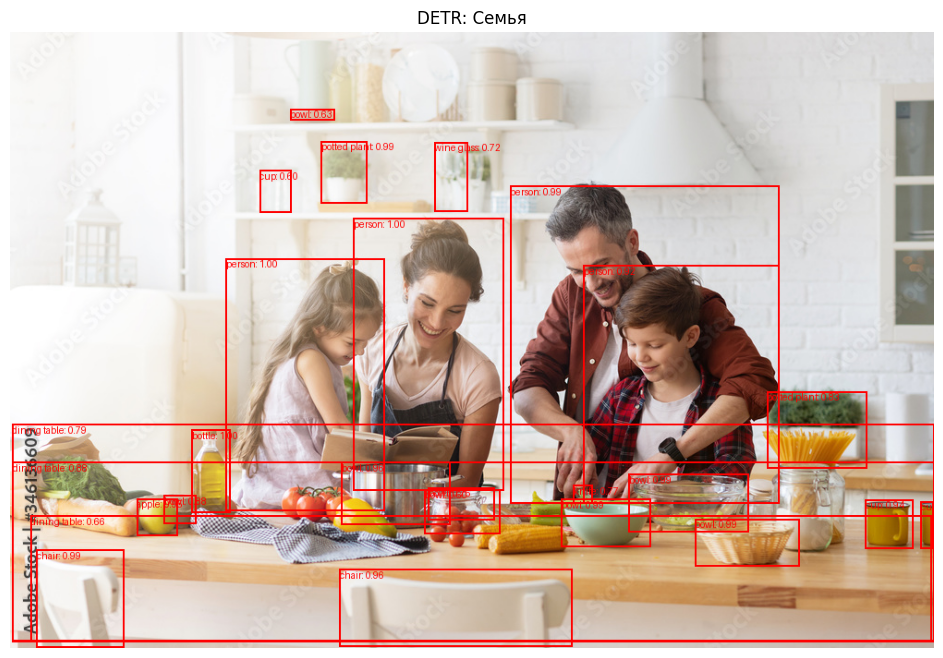

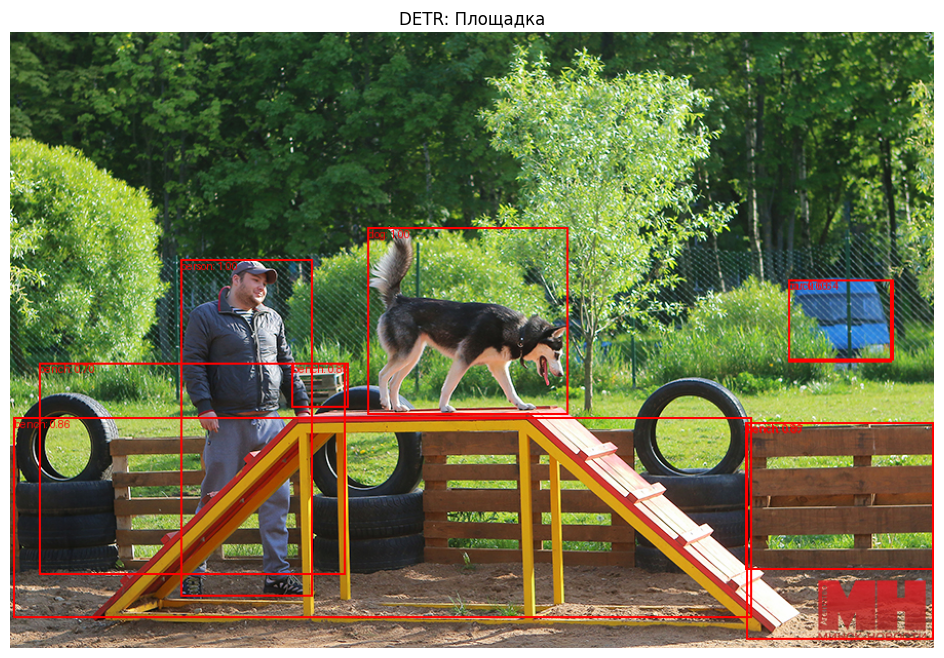

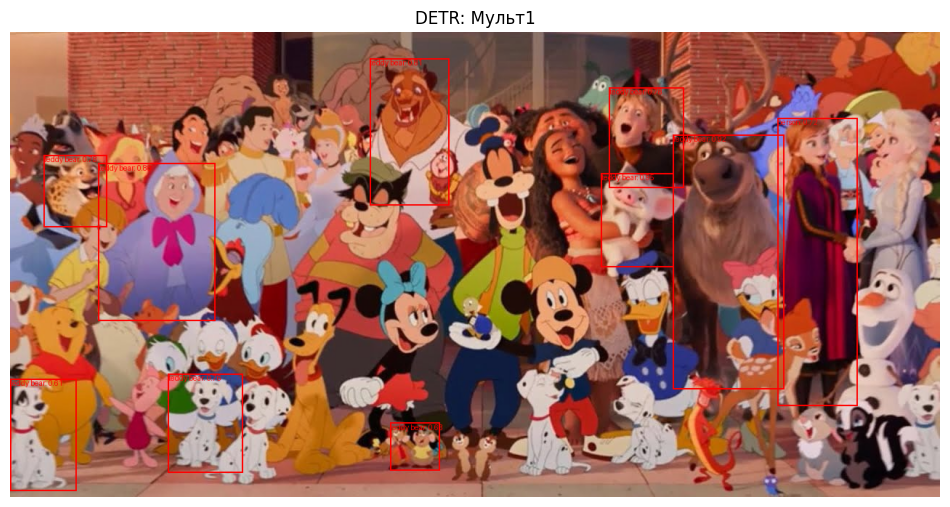

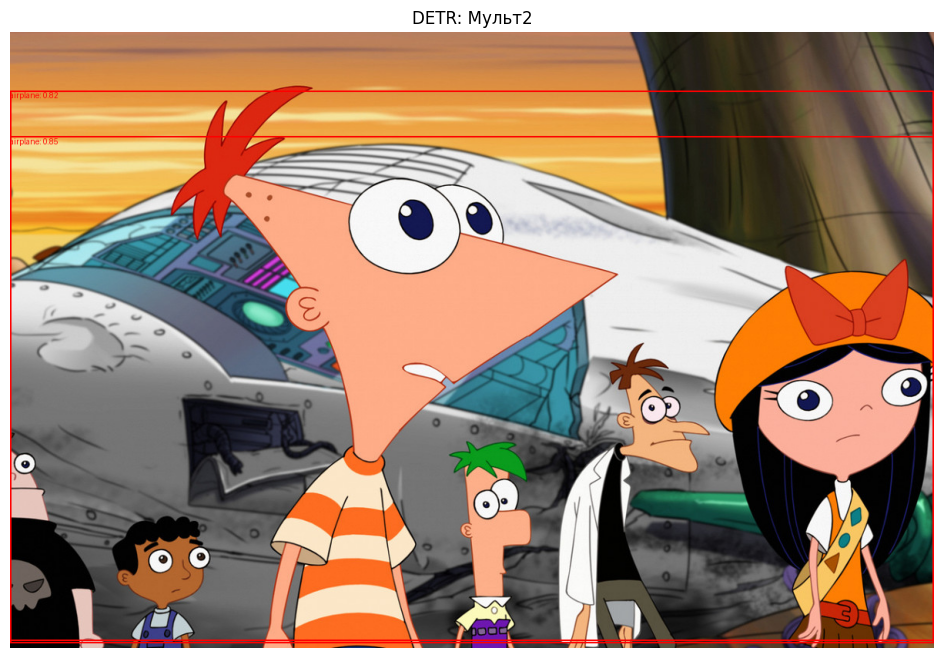

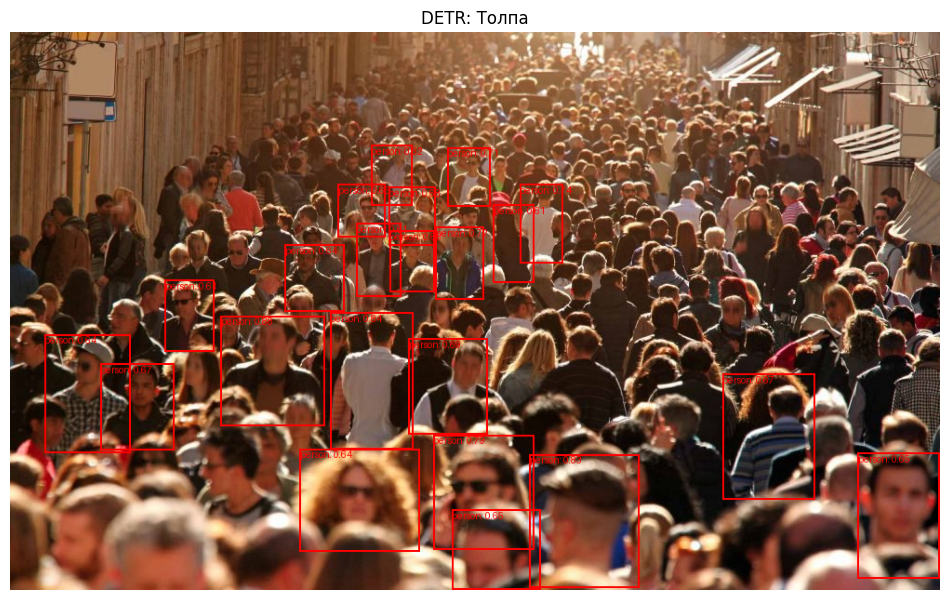

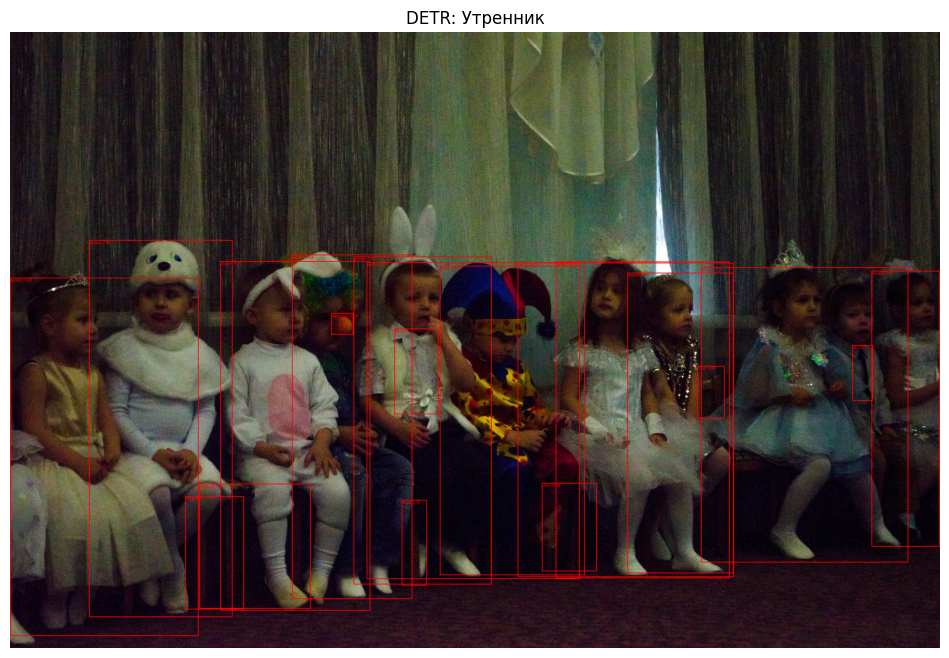

Время выполнения: 39.19 секунд


In [17]:
# @title DETR (DEtection TRansformer) фото

from transformers import DetrImageProcessor, DetrForObjectDetection
import warnings
warnings.filterwarnings("ignore")


start_time = time.time()

image_paths = [
    '/content/drive/MyDrive/pictures_for_detection/Дорога.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Семья.jpg',
    '/content/drive/MyDrive/pictures_for_detection/Площадка.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon.jpg',
    '/content/drive/MyDrive/pictures_for_detection/cartoon2.jpg',
    '/content/drive/MyDrive/pictures_for_detection/crowd.jpg',
    '/content/drive/MyDrive/pictures_for_detection/sun.jpg',
]
titles = ["Дорога", "Семья", "Площадка", "Мульт1", "Мульт2", "Толпа", "Утренник"]

threshold = 0.6

# Загрузка модели и процессора
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50").eval()

for path, title in zip(image_paths, titles):
    image = Image.open(path).convert("RGB")

    # Подготовка входа
    inputs = processor(images=image, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs)

    # Получение предсказаний
    target_sizes = torch.tensor([image.size[::-1]])  # (H, W)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    # Отрисовка боксов
    draw = ImageDraw.Draw(image)
    font = ImageFont.load_default()

    for box, score, label in zip(results["boxes"], results["scores"], results["labels"]):
        box = [round(i, 2) for i in box.tolist()]
        cls = model.config.id2label[label.item()]
        draw.rectangle(box, outline="red", width=2)
        draw.text((box[0], box[1]), f"{cls}: {score:.2f}", fill="red", font=font)

    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(f"DETR: {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

In [18]:
# @title DETR (DEtection TRansformer) видео


# Инициализация
start_time = time.time()

# Загрузка модели и процессора
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50").eval()

# Параметры
video_path = "/content/drive/MyDrive/pictures_for_detection/1.mp4"
output_path = "output_detr_people.avi"
threshold = 0.6
max_processed = 100  # сколько кадров обработать

# Открытие видео
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

frame_count = 0
processed_frames = 0

font = ImageFont.load_default()

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1
    # Преобразуем кадр для PIL и DETR
    image_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)).convert("RGB")

    inputs = processor(images=image_pil, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)

    target_sizes = torch.tensor([image_pil.size[::-1]])  # (H, W)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    draw = ImageDraw.Draw(image_pil)

    for box, score, label in zip(results["boxes"], results["scores"], results["labels"]):
        box = [round(i, 2) for i in box.tolist()]
        cls = model.config.id2label[label.item()]
        draw.rectangle(box, outline="red", width=2)
        draw.text((box[0], box[1]), f"{cls}: {score:.2f}", fill="red", font=font)

    # Обратно в OpenCV-формат
    frame_out = cv2.cvtColor(np.array(image_pil), cv2.COLOR_RGB2BGR)
    out.write(frame_out)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nPeople Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")


video_path = "/content/drive/MyDrive/pictures_for_detection/city.mp4"
output_path = "output_detr_city.avi"
threshold = 0.6
max_processed = 100  # сколько кадров обработать

# Открытие видео
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise IOError(f"Не удалось открыть видео: {video_path}")

fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*"XVID"), fps, (w, h))

frame_count = 0
processed_frames = 0

font = ImageFont.load_default()

while cap.isOpened() and processed_frames < max_processed:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1
    # Преобразуем кадр для PIL и DETR
    image_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)).convert("RGB")

    inputs = processor(images=image_pil, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)

    target_sizes = torch.tensor([image_pil.size[::-1]])  # (H, W)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    draw = ImageDraw.Draw(image_pil)

    for box, score, label in zip(results["boxes"], results["scores"], results["labels"]):
        box = [round(i, 2) for i in box.tolist()]
        cls = model.config.id2label[label.item()]
        draw.rectangle(box, outline="red", width=2)
        draw.text((box[0], box[1]), f"{cls}: {score:.2f}", fill="red", font=font)

    # Обратно в OpenCV-формат
    frame_out = cv2.cvtColor(np.array(image_pil), cv2.COLOR_RGB2BGR)
    out.write(frame_out)
    processed_frames += 1

cap.release()
out.release()

end_time = time.time()
print(f"\nPeople Итог: обработано {processed_frames} кадров из {frame_count}")
print(f"People Время выполнения: {end_time - start_time:.2f} секунд")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).



People Итог: обработано 100 кадров из 100
People Время выполнения: 440.63 секунд

People Итог: обработано 100 кадров из 100
People Время выполнения: 872.76 секунд


## Выводы

Сравнительная таблица

| Модель         | Тип                   | Скорость | Точность | Простота | Где использовать                                         |
|----------------|------------------------|----------|----------|----------|----------------------------------------------------------|
| HOG + SVM      | Классика               | ⭐⭐⭐⭐⭐   | ⭐⭐       | ⭐⭐⭐⭐⭐   | Простой фоновый детектор, пешеходы                       |
| Fast R-CNN     | 2-stage                | ⭐⭐      | ⭐⭐⭐⭐     | ⭐⭐       | Сложные задачи, нужна Selective Search                  |
| Faster R-CNN   | 2-stage                | ⭐⭐⭐     | ⭐⭐⭐⭐⭐    | ⭐⭐       | Высокая точность, подходит для фото и промышленных задач|
| YOLOv5         | 1-stage                | ⭐⭐⭐⭐⭐   | ⭐⭐⭐      | ⭐⭐⭐⭐     | Реальное время: дроны, камеры, мобильные устройства     |
| SSD            | 1-stage                | ⭐⭐⭐⭐    | ⭐⭐⭐      | ⭐⭐⭐⭐     | Легкий детектор, подходит для встраиваемых систем        |
| RetinaNet      | 1-stage                | ⭐⭐⭐⭐    | ⭐⭐⭐⭐     | ⭐⭐       | Классовый дисбаланс, медицина, сложные фоновые сцены     |
| FCOS           | 1-stage (Anchor-Free)  | ⭐⭐⭐⭐    | ⭐⭐⭐⭐     | ⭐⭐⭐      | Без якорей: плотные сцены, улицы, перекрытия объектов    |
| DETR           | 1-stage (Transformer)  | ⭐⭐      | ⭐⭐⭐⭐     | ⭐        | Тяжёлый, но мощный трансформер, требует много данных     |

Финальные выводы:

*   Классические методы (HOG) хороши для быстрых и простых задач с простым фоном. Отличный выбор для пешеходов и задач без необходимости нейросетей.
*   Faster R-CNN и RetinaNet обеспечивают высокую точность, особенно в ситуациях с ограниченными ресурсами на тренировку, сложными классами или дисбалансом данных. Идеальны для промышленности и медицины.
*   YOLO и SSD — лидеры по скорости и пригодности для реального времени, включая встроенные системы (дроны, камеры, авто).
*   FCOS — современный anchor-free подход, избавляющий от необходимости подбора anchor boxes. Универсален, хорошо справляется с обнаружением объектов в плотных, сложных и загромождённых сценах. Лёгкий в адаптации и переносе на новые домены. Особенно полезен при наличии плотных объектов без явно выраженных форм.
*   DETR — новый класс детекторов на основе трансформеров. Очень мощный, особенно на крупных и разнообразных датасетах, но требует значительных ресурсов. За ним будущее, особенно при совместном развитии vision+language систем.







